<a href="https://colab.research.google.com/github/CFretter/komorebi/blob/main/komorebi_convolution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

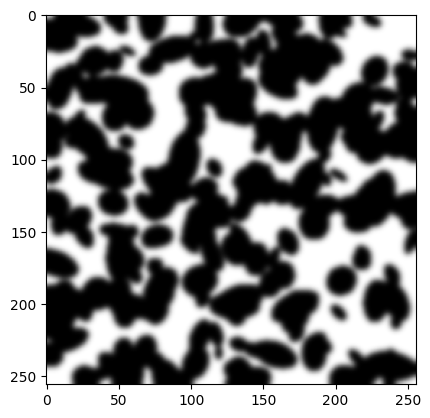

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.draw import ellipse
from scipy.ndimage import gaussian_filter
import numpy as np
import math
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import matplotlib.animation
from IPython.display import HTML
from skimage import exposure
import torch


def create_cheese_grater_matrix(rows, cols, radius):
  """
  Creates a numpy matrix with regular spaced circles like a cheese grater.

  Args:
    rows: Number of rows in the matrix.
    cols: Number of columns in the matrix.
    radius: Radius of the circles.

  Returns:
    A numpy matrix with circles.
  """
  # Create an empty matrix
  matrix = np.zeros((rows, cols))

  # Calculate center coordinates for circles
  center_x = np.arange(radius, cols, 3 * radius)
  center_y = np.arange(radius, rows, 3 * radius)

  # Create circles
  for x in center_x:
    for y in center_y:
      # Use np.mgrid instead of np.ogrid to get matrices of the same size
      y_coords, x_coords = np.mgrid[
          -radius:radius:1, -radius:radius:1
      ]
      mask = (x_coords**2 + y_coords**2) <= radius**2
      # Directly apply the mask to the slice
      matrix[
          int(y - radius) : int(y + radius), int(x - radius) : int(x + radius)
      ] = mask


  return matrix

def create_matrix_with_ellipses(num_ellipses,sigma=0):
  """
  Creates an empty matrix and draws a given number of black ellipses on it.

  Args:
    num_ellipses: The number of ellipses to draw.

  Returns:
    A NumPy array representing the matrix with the drawn ellipses.
  """

  # Create an empty matrix
  matrix_size = 256
  matrix = np.ones((matrix_size, matrix_size))
 
  # Draw ellipses
  for _ in range(num_ellipses):
    # Generate random ellipse parameters
    x = np.random.randint(0, matrix_size)
    y = np.random.randint(0, matrix_size)
    r = np.random.randint(5, 12)
    c = int(np.random.uniform(0.5, 2)*r)
    angle = np.random.randint(0, 360)

    # Draw the ellipse
    rr, cc = ellipse(x, y, r, c,shape=[matrix_size,matrix_size ], rotation=angle)
    matrix[rr, cc] = 0

  return gaussian_filter(matrix, sigma)

# Call the function to create the matrix
matrix = create_matrix_with_ellipses(250,2)

# Plot the matrix as an image
plt.imshow(matrix, cmap='gray')
plt.show()

C:\Users\chris\AppData\Local\Temp\ipykernel_4992\3008949307.py:5: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at ..\aten\src\ATen\native\Convolution.cpp:1032.)
  return torch.conv2d( a_t,b_t, padding='same').squeeze().numpy()


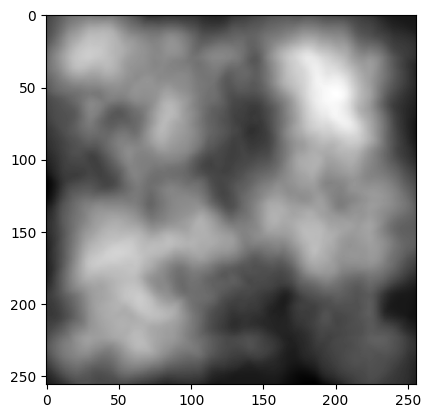

In [9]:
def convolve(a,b):
    
    a_t = torch.tensor(a).unsqueeze(0).unsqueeze(0)
    b_t = torch.tensor(b).unsqueeze(0).unsqueeze(0)
    return torch.conv2d( a_t,b_t, padding='same').squeeze().numpy()

def make_layer(leave_cnt,sun_size):
    leaves=create_matrix_with_ellipses(leave_cnt,0)
    sun = create_cheese_grater_matrix(sun_size*2,sun_size*2,sun_size)
    return convolve(leaves,sun)
convolved =make_layer(250,32)
plt.imshow(convolved, cmap='gray')


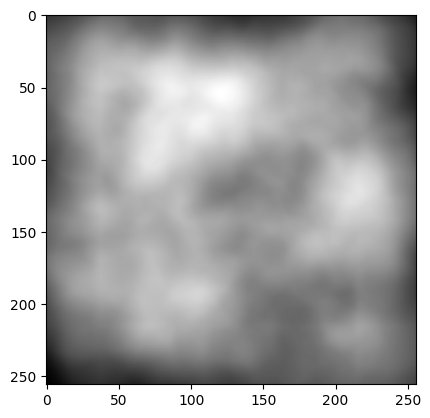

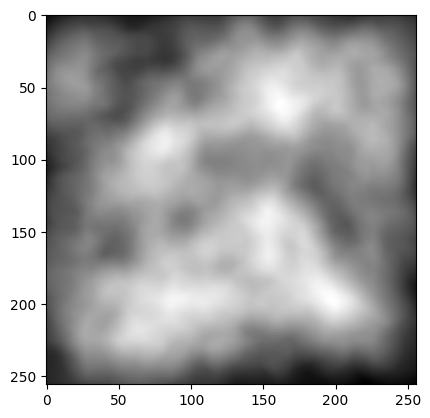

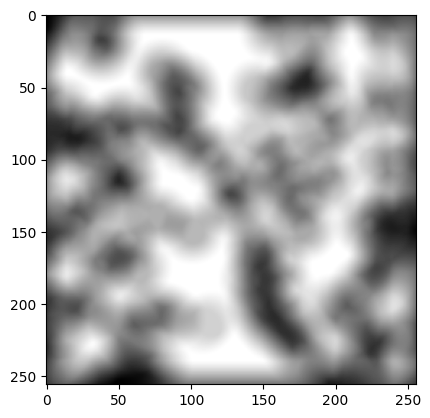

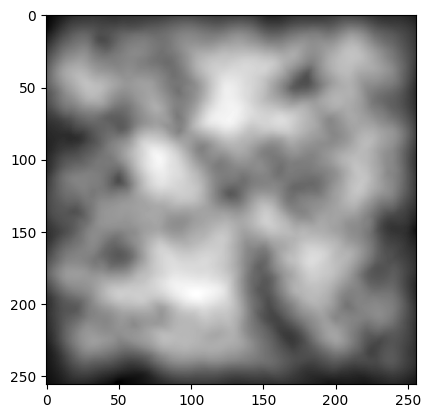

In [10]:

l1 =make_layer(150,40)
plt.imshow(l1, cmap='gray')
plt.show()
l2 =make_layer(150,30)
plt.imshow(l2, cmap='gray')
plt.show()
l3 =make_layer(100,16)
plt.imshow(l3, cmap='gray')
plt.show()
plt.imshow(exposure.adjust_gamma(l1*l2*l3, 0.5) , cmap='gray')
plt.show()

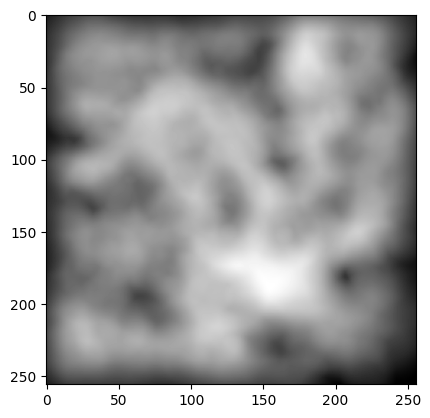

In [50]:
def make_stack_joined(ls,ss):
    re =make_layer(ls[0],ss[0])
    for l,s in zip(ls[1:],ss[1:]):
        re*=make_layer(l,s)
    return  exposure.adjust_gamma(re, 0.5) 
stack=make_stack_joined([150,150,100],[40,30,16])
plt.imshow(stack, cmap='gray')
plt.show()

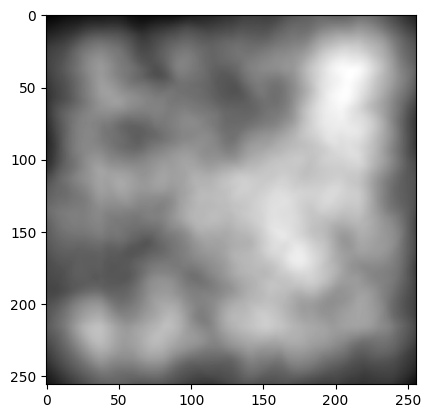

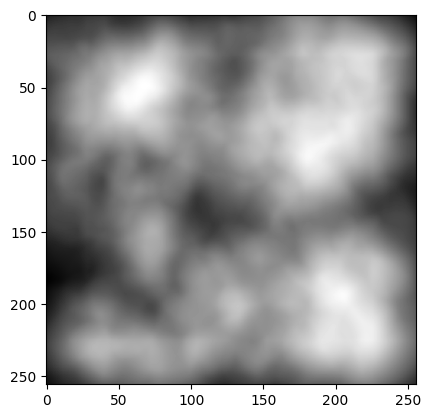

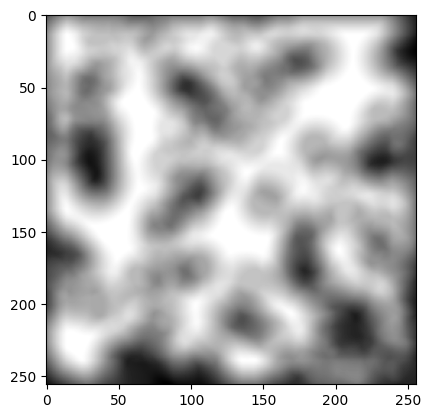

In [51]:
def make_stack_raw(ls,ss):
    re=[]
    for l,s in zip(ls,ss):
        re.append(make_layer(l,s))
    return  re
layers=make_stack_raw([150,150,100],[40,30,16])
for l in layers:
     plt.imshow(l, cmap='gray')
     plt.show()

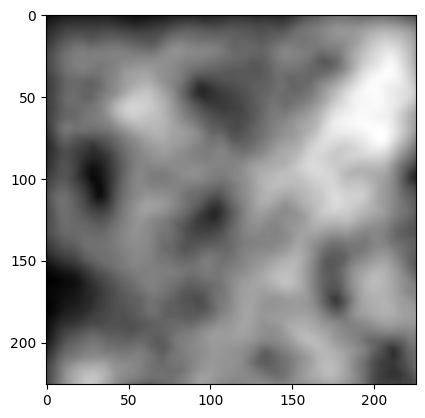

In [52]:
def merge_stack_off(layers,margin,oxs,oys):
    
    re =layers[0].copy()[oxs[0]:-margin+oxs[0],oys[0]:-margin+oys[0]]
    for la,ox,oy in zip(layers[1:],oxs[1:],oys[1:]):
        ne=la[ox:-margin+ox,oy:-margin+oy]
      #  print(re.shape,ne.shape)
        re*=ne
    return  exposure.adjust_gamma(re, 0.5) 
stack=merge_stack_off(layers,30,[2, 3, 3],[9, 4, 2])
plt.imshow(stack, cmap='gray')

In [53]:
n_frames=200
frames=[]
margin=10
for i in range(n_frames):
    xoff1=int(math.sin(i*0.25+2)*10/2+10/2)
    yoff1=int(math.sin(i*0.42+2)*10/2+10/2)
    xoff2=int(math.sin(i*0.22+3)*margin/2*0.8+margin/2)
    yoff2=int(math.sin(i*0.32+7)*margin/2+margin/2)
    xoff3=int(math.sin(i*0.18+8)*margin/2*0.2+margin/2)
    yoff3=int(math.sin(i*0.22+10)*margin/2*0.3+margin/2)
    xoffs=[xoff1,xoff2,xoff3]
    yoffs=[yoff1,yoff2,yoff3]
   # print(i,xoffs,yoffs)
    
  #  print(margin)
    result=merge_stack_off(layers,margin,xoffs,yoffs)
    frames.append(result)

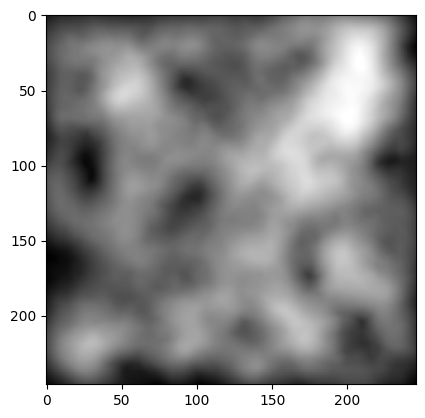

In [54]:
from ipywidgets import interact, IntSlider
import matplotlib.pyplot as plt

fig = plt.figure()
#plt.axis('off')
#plt.axis("tight")  # gets rid of white border
#plt.axis("image") 
im = plt.imshow(frames[0], cmap='gray')

total_amp=10
def animate(i):
  
  
  im.set_array(frames[i])
  
  return im,

ani = FuncAnimation(fig, animate, frames=len(frames), interval=100, blit=True, repeat=True)
HTML(ani.to_jshtml())

In [49]:
FFMpegWriter = matplotlib.animation.writers['ffmpeg']
metadata = dict(title='Movie Test', artist='Matplotlib',
                comment='Movie support!')
writer = FFMpegWriter(fps=15, metadata=metadata,codec="webp",extra_args=["-lossless", "1"])
ani.save('movie.webp', writer=writer)

In [33]:
writer = matplotlib.animation.PillowWriter(fps=15,
                                 metadata=dict(artist='Me'),
                                 bitrate=1800)
ani.save('movie.webp', writer=writer)